CRATIO

Còdecs: zstd, zlib i lz4hc

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import plotly.express as px
import numpy as np
import aux_funcs

In [2]:
from pathlib import Path
path = Path('../data_inputs_temp/')

In [3]:
ficheros = ['entropy-shuffle', 'zstd-shuffle-split', 'zlib-shuffle-split', 'lz4hc-shuffle-split']
categories = ["30", "0", "1", "2"]

dataframes1 = {}
for i in range(len(ficheros)):
    dataframes1[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [4]:
path = Path('../data_inputs')

dataframes2 = {}
for i in range(len(ficheros)):
    dataframes2[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [5]:
path = Path('../data_inputs_wind/')

dataframes3 = {}
for i in range(len(ficheros)):
    dataframes3[ficheros[i]] = aux_funcs.get_filtered_df(path, ficheros[i], category=categories[i])

In [6]:
df_fig = pd.DataFrame()
for i in range(0, len(ficheros)):
    df_fig = pd.concat([df_fig, dataframes1[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes2[ficheros[i]]], axis = 0)
    df_fig = pd.concat([df_fig, dataframes3[ficheros[i]]], axis = 0)

df_fig

,cratio,speed,special_vals,nchunk,category,codec_filter,categoria
0,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,30
1,2.02,2.340000e+09,0,0,-1,entropy-shuffle,30
2,5.73,5.700000e+09,0,0,-1,entropy-shuffle,30
3,13100.00,5.410000e+09,1,0,-1,entropy-shuffle,30
4,16400.00,5.410000e+09,1,0,-1,entropy-shuffle,30
...,...,...,...,...,...,...,...
55291,16400.00,5.420000e+09,1,215,7,lz4hc-shuffle-split,2
55292,16400.00,5.410000e+09,1,215,7,lz4hc-shuffle-split,2
55293,16400.00,5.420000e+09,1,215,7,lz4hc-shuffle-split,2
55294,16400.00,5.420000e+09,1,215,7,lz4hc-shuffle-split,2


In [7]:
df_fig = df_fig[df_fig['special_vals'] == 0]

In [8]:
fig = px.scatter(df_fig, "cratio", "speed", color = "categoria")
fig.show()

0: zstd

1: zlib

2: lz4hc

# DATAFRAME FILTRE shuffle

In [9]:
df_entropy = pd.DataFrame()
df_entropy = pd.concat([df_entropy, dataframes1[ficheros[0]], dataframes2[ficheros[0]], 
                       dataframes3[ficheros[0]]], axis = 0)

df_entropy.rename(columns = {'cratio':'cratio31', 'speed':'speed31', 'special_vals':'special_vals31'}, inplace = True)
df_entropy = df_entropy.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [10]:
df_zstd = pd.DataFrame()
df_zstd = pd.concat([df_zstd, dataframes1[ficheros[1]], dataframes2[ficheros[1]], 
                       dataframes3[ficheros[1]]], axis = 0)

df_zstd.rename(columns = {'cratio':'cratio0', 'speed':'speed0', 'special_vals':'special_vals0'}, inplace = True)
df_zstd = df_zstd.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [11]:
df_zlib = pd.DataFrame()
df_zlib = pd.concat([df_zlib, dataframes1[ficheros[2]], dataframes2[ficheros[2]], 
                        dataframes3[ficheros[2]]], axis = 0)

df_zlib.rename(columns = {'cratio':'cratio1', 'speed':'speed1', 'special_vals':'special_vals1'}, inplace = True)
df_zlib = df_zlib.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [12]:
df_lz4hc = pd.DataFrame()
df_lz4hc = pd.concat([df_lz4hc, dataframes1[ficheros[3]], dataframes2[ficheros[3]], 
                        dataframes3[ficheros[3]]], axis = 0)

df_lz4hc.rename(columns = {'cratio':'cratio2', 'speed':'speed2', 'special_vals':'special_vals2'}, inplace = True)
df_lz4hc = df_lz4hc.drop(['nchunk', 'category', 'codec_filter', 'categoria'], axis = 1)

In [13]:
df_shuffle = pd.DataFrame()
df_shuffle = pd.concat([df_shuffle, df_zstd, df_zlib, df_lz4hc, df_entropy], axis = 1)
df_shuffle

,cratio0,speed0,special_vals0,cratio1,speed1,special_vals1,cratio2,speed2,special_vals2,cratio31,speed31,special_vals31
0,16400.0,5.520000e+09,1,16400.00,5.390000e+09,1,16400.00,5.540000e+09,1,16400.00,5.410000e+09,1
1,4.9,6.950000e+06,0,4.78,2.470000e+07,0,3.39,1.850000e+07,0,2.02,2.340000e+09,0
2,17.1,1.850000e+07,0,14.80,4.230000e+07,0,10.60,3.210000e+07,0,5.73,5.700000e+09,0
3,13100.0,5.520000e+09,1,13100.00,5.520000e+09,1,13100.00,5.520000e+09,1,13100.00,5.410000e+09,1
4,16400.0,5.540000e+09,1,16400.00,5.540000e+09,1,16400.00,5.520000e+09,1,16400.00,5.410000e+09,1
...,...,...,...,...,...,...,...,...,...,...,...,...
55291,16400.0,5.580000e+09,1,16400.00,5.580000e+09,1,16400.00,5.420000e+09,1,16400.00,5.410000e+09,1
55292,16400.0,5.460000e+09,1,16400.00,5.520000e+09,1,16400.00,5.410000e+09,1,16400.00,5.310000e+09,1
55293,16400.0,5.440000e+09,1,16400.00,5.580000e+09,1,16400.00,5.420000e+09,1,16400.00,5.540000e+09,1
55294,16400.0,5.460000e+09,1,16400.00,5.480000e+09,1,16400.00,5.420000e+09,1,16400.00,5.580000e+09,1


Eliminar special_value (que lo sea en alguna de las 4 categorías)

In [14]:
df_shuffle = aux_funcs.delete_special_vals(df_shuffle, ["special_vals0", "special_vals1", "special_vals2", "special_vals31"])

In [15]:
df_input_x = df_shuffle.iloc[:, [9, 10]]

In [16]:
df_input_x

,cratio31,speed31
1,2.02,2.340000e+09
2,5.73,5.700000e+09
5,2.11,2.700000e+09
6,6.10,6.340000e+09
9,2.23,2.710000e+09
...,...,...
55203,21.80,1.440000e+10
55206,3.70,4.770000e+09
55207,19.00,1.380000e+10
55210,3.99,5.190000e+09


Cálculo del SCORE

In [17]:
df_shuffle = df_shuffle.drop(['cratio31', 'speed31', 'special_vals31', 'special_vals0', 'special_vals1', 'special_vals2'], axis = 1)

In [18]:
df_shuffle

,cratio0,speed0,cratio1,speed1,cratio2,speed2
1,4.90,6950000.0,4.78,24700000.0,3.39,18500000.0
2,17.10,18500000.0,14.80,42300000.0,10.60,32100000.0
5,4.95,7130000.0,4.87,25300000.0,3.41,18900000.0
6,18.20,19600000.0,16.20,45400000.0,10.90,32300000.0
9,5.17,7130000.0,5.14,25300000.0,3.50,18800000.0
...,...,...,...,...,...,...
55203,152.00,64000000.0,111.00,117000000.0,75.50,108000000.0
55206,13.30,25300000.0,12.80,74100000.0,10.30,67800000.0
55207,148.00,62000000.0,110.00,121000000.0,78.30,111000000.0
55210,29.90,61200000.0,27.50,114000000.0,21.10,106000000.0


In [19]:
dfcratios = pd.DataFrame()
for i in range(0, 3):
    dfcratios = pd.concat([dfcratios, df_shuffle.iloc[:, 2*i]], axis =0)

In [20]:
desv_cratio = dfcratios.std()[0]
desv_cratio

208.05926512360497

In [21]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

50.47411044808042

In [22]:
dfspeeds = pd.DataFrame()
for i in range(0, 3):
    dfspeeds = pd.concat([dfspeeds, df_shuffle.iloc[:, 2*i+1]], axis =0)

In [23]:
mean_speed = dfspeeds.mean()[0]
mean_speed

39376518.19056785

In [24]:
desv_speed = dfspeeds.std()[0]
desv_speed

90027647.01752351

In [25]:
theta = 0.96

cratio0 = df_shuffle["cratio0"]
speed0 = df_shuffle["speed0"]
ncratio0 = (cratio0 - mean_cratio) / desv_cratio
nspeed0 = (speed0 - mean_speed) / desv_speed
df_shuffle.insert(2, 0, theta*ncratio0 + (1-theta)*nspeed0)

cratio1 = df_shuffle["cratio1"]
speed1 = df_shuffle["speed1"]
ncratio1 = (cratio1 - mean_cratio) / desv_cratio
nspeed1 = (speed1 - mean_speed) / desv_speed
df_shuffle.insert(5, 1, theta*ncratio1 + (1-theta)*nspeed1)

cratio2 = df_shuffle["cratio2"]
speed2 = df_shuffle["speed2"]
ncratio2 = (cratio2 - mean_cratio) / desv_cratio
nspeed2 = (speed2 - mean_speed) / desv_speed
df_shuffle.insert(8, 2, theta*ncratio2 + (1-theta)*nspeed2)

In [26]:
df_shuffle

,cratio0,speed0,0,cratio1,speed1,1,cratio2,speed2,2
1,4.90,6950000.0,-0.224689,4.78,24700000.0,-0.217357,3.39,18500000.0,-0.226525
2,17.10,18500000.0,-0.163266,14.80,42300000.0,-0.163304,10.60,32100000.0,-0.187215
5,4.95,7130000.0,-0.224379,4.87,25300000.0,-0.216675,3.41,18900000.0,-0.226255
6,18.20,19600000.0,-0.157702,16.20,45400000.0,-0.155467,10.90,32300000.0,-0.185742
9,5.17,7130000.0,-0.223364,5.14,25300000.0,-0.215429,3.50,18800000.0,-0.225884
...,...,...,...,...,...,...,...,...,...
55203,152.00,64000000.0,0.479388,111.00,117000000.0,0.313759,75.50,108000000.0,0.145961
55206,13.30,25300000.0,-0.177778,12.80,74100000.0,-0.158403,10.30,67800000.0,-0.172737
55207,148.00,62000000.0,0.460043,110.00,121000000.0,0.310923,78.30,111000000.0,0.160213
55210,29.90,61200000.0,-0.085234,27.50,114000000.0,-0.072848,21.10,106000000.0,-0.105933


In [27]:
df_pos = df_shuffle
df_pos = df_pos.drop(['cratio0', 'speed0', 'cratio1', 'speed1', 'cratio2', 'speed2'], axis = 1)

In [28]:
df_pos

,0,1,2
1,-0.224689,-0.217357,-0.226525
2,-0.163266,-0.163304,-0.187215
5,-0.224379,-0.216675,-0.226255
6,-0.157702,-0.155467,-0.185742
9,-0.223364,-0.215429,-0.225884
...,...,...,...
55203,0.479388,0.313759,0.145961
55206,-0.177778,-0.158403,-0.172737
55207,0.460043,0.310923,0.160213
55210,-0.085234,-0.072848,-0.105933


EJERCICIO TOIA

In [29]:
col = df_pos.iloc[:, 0]
df = col.to_frame(name='punct')
df

df_0 = pd.DataFrame()
df_0 = pd.concat([df_0, df], axis = 0)
categoria = np.repeat(str(0), 77925)
df_0['categoria'] = categoria
df_0

,punct,categoria
1,-0.224689,0
2,-0.163266,0
5,-0.224379,0
6,-0.157702,0
9,-0.223364,0
...,...,...
55203,0.479388,0
55206,-0.177778,0
55207,0.460043,0
55210,-0.085234,0


In [30]:
col = df_pos.iloc[:, 1]
df = col.to_frame(name='punct')
df

df_1 = pd.DataFrame()
df_1 = pd.concat([df_1, df], axis = 0)
categoria = np.repeat('1', 77925)
df_1['categoria'] = categoria
df_1

,punct,categoria
1,-0.217357,1
2,-0.163304,1
5,-0.216675,1
6,-0.155467,1
9,-0.215429,1
...,...,...
55203,0.313759,1
55206,-0.158403,1
55207,0.310923,1
55210,-0.072848,1


In [31]:
df_fig = pd.DataFrame()
df_fig = pd.concat([df_fig, df_0, df_1], axis = 0)
df_fig

,punct,categoria
1,-0.224689,0
2,-0.163266,0
5,-0.224379,0
6,-0.157702,0
9,-0.223364,0
...,...,...
55203,0.313759,1
55206,-0.158403,1
55207,0.310923,1
55210,-0.072848,1


In [32]:
fig = px.scatter(df_fig, "punct", "categoria", color = "categoria")
fig.show()

FIN EJERCICIO

In [33]:
best_categ_shuffle = df_pos.idxmax(axis=1)
best_categ_shuffle = pd.DataFrame(best_categ_shuffle, columns=['best_categ'])
best_categ_shuffle

,best_categ
1,1
2,0
5,1
6,1
9,1
...,...
55203,0
55206,1
55207,0
55210,1


In [34]:
categorias = best_categ_shuffle['best_categ'].unique()

In [35]:
unique, counts = np.unique(best_categ_shuffle, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 10749],
       [    1, 57558],
       [    2,  9618]])

In [36]:
df_t = pd.DataFrame()
df_t = pd.concat([df_t, df_input_x['cratio31']], axis = 1)
df_t = pd.concat([df_t, df_input_x['speed31']], axis = 1)
df_t = pd.concat([df_t, best_categ_shuffle], axis = 1)
df_t

,cratio31,speed31,best_categ
1,2.02,2.340000e+09,1
2,5.73,5.700000e+09,0
5,2.11,2.700000e+09,1
6,6.10,6.340000e+09,1
9,2.23,2.710000e+09,1
...,...,...,...
55203,21.80,1.440000e+10,0
55206,3.70,4.770000e+09,1
55207,19.00,1.380000e+10,0
55210,3.99,5.190000e+09,1


In [37]:
df_t_noblc = df_t.copy()

Balancear

In [38]:
df_blc = pd.DataFrame()
for i in categorias:
    df_i = df_t[df_t['best_categ'] == i]
    df_i = df_i.head(n=9618)
    df_blc = pd.concat([df_blc, df_i], axis = 0)
        
df_blc

,cratio31,speed31,best_categ
1,2.02,2.340000e+09,1
5,2.11,2.700000e+09,1
6,6.10,6.340000e+09,1
9,2.23,2.710000e+09,1
10,6.04,6.030000e+09,1
...,...,...,...
54922,1.00,3.320000e+09,2
55050,1.11,2.490000e+09,2
55114,1.05,2.750000e+09,2
55174,1.02,2.900000e+09,2


In [39]:
dfinput_y = pd.DataFrame()
dfinput_y = pd.concat([dfinput_y, df_blc['best_categ']], axis = 1)
dfinput_y.shape

(28854, 1)

In [40]:
dfinput_x = df_blc.drop(['best_categ'], axis = 1)
dfinput_x.shape

(28854, 2)

Normalizar inputs

In [41]:
dfcratios = pd.DataFrame()
dfcratios = pd.concat([dfcratios, dfinput_x.iloc[:, 0]], axis =0)

In [42]:
desv_cratio = dfcratios.std()[0]
desv_cratio

53.93514190654935

In [43]:
mean_cratio = dfcratios.mean()[0]
mean_cratio

30.56446315935399

In [44]:
dfspeeds = pd.DataFrame()
dfspeeds = pd.concat([dfspeeds, dfinput_x.iloc[:, 1]], axis =0)

In [45]:
mean_speed = dfspeeds.mean()[0]
mean_speed

7146869134.262147

In [46]:
desv_speed = dfspeeds.std()[0]
desv_speed

6219969011.615214

In [47]:
dfinput_x

,cratio31,speed31
1,2.02,2.340000e+09
5,2.11,2.700000e+09
6,6.10,6.340000e+09
9,2.23,2.710000e+09
10,6.04,6.030000e+09
...,...,...
54922,1.00,3.320000e+09
55050,1.11,2.490000e+09
55114,1.05,2.750000e+09
55174,1.02,2.900000e+09


In [48]:
cratio = dfinput_x["cratio31"]
speed = dfinput_x["speed31"]
ncratio = (cratio - mean_cratio) / desv_cratio
nspeed = (speed - mean_speed) / desv_speed

dfinput_x_norm = pd.DataFrame()
dfinput_x_norm.insert(0, "ncratio", ncratio)
dfinput_x_norm.insert(1, "nspeed", nspeed)

In [49]:
dfinput_x_norm

,ncratio,nspeed
1,-0.529237,-0.772812
5,-0.527568,-0.714934
6,-0.453590,-0.129722
9,-0.525343,-0.713327
10,-0.454703,-0.179562
...,...,...
54922,-0.548148,-0.615255
55050,-0.546109,-0.748697
55114,-0.547221,-0.706896
55174,-0.547778,-0.682780


In [50]:
dfinput_x = dfinput_x_norm

In [51]:
dfinput_y

,best_categ
1,1
5,1
6,1
9,1
10,1
...,...
54922,2
55050,2
55114,2
55174,2


In [52]:
#dfinput_x = dfinput_x.to_csv('dfinput_x.csv')
#dfinput_y = dfinput_y.to_csv('dfinput_y.csv')

In [53]:
dfinput_y

,best_categ
1,1
5,1
6,1
9,1
10,1
...,...
54922,2
55050,2
55114,2
55174,2


In [54]:
dfinput_x.shape

(28854, 2)

In [55]:
dfinput_y.shape

(28854, 1)

In [56]:
dfinput_x_noblc = df_t_noblc.iloc[:, [0, 1]]

In [57]:
dfinput_y_noblc = pd.DataFrame()
dfinput_y_noblc = pd.concat([df_t_noblc.iloc[:, 2]], axis = 1)

In [58]:
dfinput_x_noblc.shape

(77925, 2)

In [59]:
dfinput_y_noblc.shape

(77925, 1)

# RED NEURONAL (2 categorías)

In [60]:
from keras.utils import to_categorical
dfinput_y = to_categorical(dfinput_y)

2022-12-28 12:15:51.299290: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [61]:
from keras import models, layers
import tensorflow

tensorflow.random.set_seed(100)

model = models.Sequential()
model.add(layers.Dense(2, activation='relu', input_shape=(2,)))
model.add(layers.Dense(25, activation='relu'))
model.add(layers.Dense(3, activation='softmax'))

2022-12-28 12:15:56.896982: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [62]:
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['acc'])

In [63]:
history = model.fit(dfinput_x, dfinput_y, epochs=35, validation_split=0.1)

Epoch 1/35
812/812 [==============================] - 3s 2ms/step - loss: 0.7711 - acc: 0.6622 - val_loss: 0.9458 - val_acc: 0.0000e+00
Epoch 2/35
812/812 [==============================] - 1s 2ms/step - loss: 0.6363 - acc: 0.6641 - val_loss: 0.8043 - val_acc: 0.0000e+00
Epoch 3/35
812/812 [==============================] - 1s 1ms/step - loss: 0.5826 - acc: 0.6649 - val_loss: 0.7856 - val_acc: 0.0000e+00
Epoch 4/35
812/812 [==============================] - 1s 1ms/step - loss: 0.5600 - acc: 0.6630 - val_loss: 0.7421 - val_acc: 0.0000e+00
Epoch 5/35
812/812 [==============================] - 1s 2ms/step - loss: 0.5485 - acc: 0.6648 - val_loss: 0.7050 - val_acc: 0.0000e+00
Epoch 6/35
812/812 [==============================] - 2s 2ms/step - loss: 0.5423 - acc: 0.6603 - val_loss: 0.6937 - val_acc: 0.9494
Epoch 7/35
812/812 [==============================] - 3s 4ms/step - loss: 0.5380 - acc: 0.6617 - val_loss: 0.7360 - val_acc: 0.0000e+00
Epoch 8/35
812/812 [==============================] 

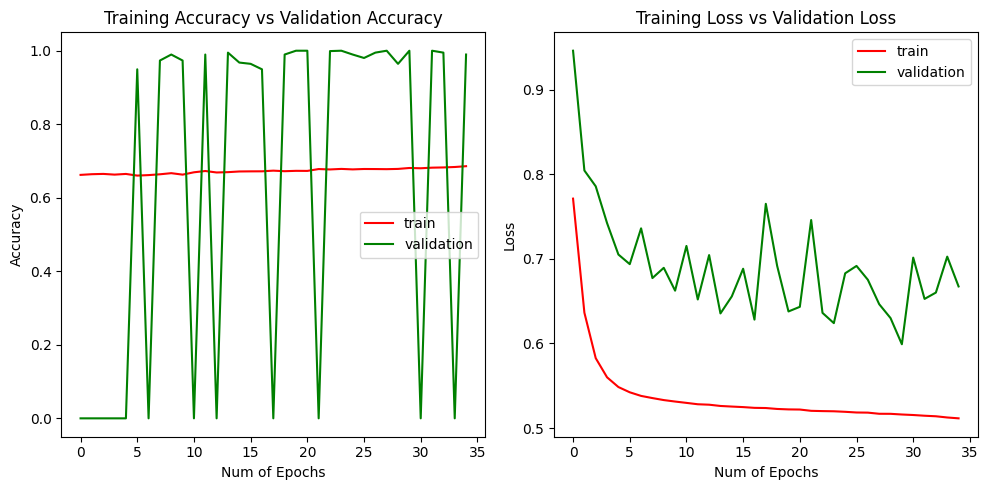

In [64]:
_, ax = plt.subplots(1, 2, figsize=(10, 5), dpi=100)
ax[0].plot(history.history['acc'], 'r')
ax[0].plot(history.history['val_acc'], 'g')
ax[0].set_xlabel("Num of Epochs")
ax[0].set_ylabel("Accuracy")
ax[0].set_title("Training Accuracy vs Validation Accuracy")
ax[0].legend(['train', 'validation'])

ax[1].plot(history.history['loss'], 'r')
ax[1].plot(history.history['val_loss'], 'g')
ax[1].set_xlabel("Num of Epochs")
ax[1].set_ylabel("Loss")
ax[1].set_title("Training Loss vs Validation Loss")
ax[1].legend(['train', 'validation'])

plt.tight_layout()

In [65]:
y_hat = model.predict(x=dfinput_x_noblc)
y_hat

2436/2436 [==============================] - 3s 1ms/step


array([[0., 0., 1.],
       [0., 0., 1.],
       [0., 0., 1.],
       ...,
       [0., 0., 1.],
       [0., 0., 1.],
       [0., 0., 1.]], dtype=float32)

In [66]:
dfinput_y_noblc = to_categorical(dfinput_y_noblc)

In [67]:
y_pred_label = np.argmax(y_hat, axis = 1)
y_true_label = np.argmax(dfinput_y_noblc, axis = 1)

In [68]:
y_pred_label

array([2, 2, 2, ..., 2, 2, 2])

In [69]:
unique, counts = np.unique(y_pred_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    2, 77925]])

In [70]:
y_true_label

array([1, 0, 1, ..., 0, 1, 0])

In [71]:
unique, counts = np.unique(y_true_label, return_counts=True)
result = np.column_stack((unique, counts))
result

array([[    0, 10749],
       [    1, 57558],
       [    2,  9618]])

In [72]:
tabla = pd.crosstab(y_pred_label, y_true_label)
tabla

col_0,0,1,2
row_0,,,
2,10749,57558,9618
